<a href="https://colab.research.google.com/github/Saarle/EDA-Project---911-calls-in-Montgomery-County/blob/main/EDA_911.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
import pandas as pd
%matplotlib inline

In [3]:
df = pd.read_csv('/content/sample_data/Montogomry, PA, 911 Calls.csv')
# ,error_bad_lines=False

print("The shape of the raw data is:", df.shape)
df.head()

The shape of the raw data is: (663522, 8)


,lat,lng,desc,zip,title,timeStamp,twp,addr
0,40.297876,-75.581294,REINDEER CT & DEAD END; NEW HANOVER; Station ...,19525.0,EMS: BACK PAINS/INJURY,12/10/2015 17:10,NEW HANOVER,REINDEER CT & DEAD END
1,40.258061,-75.264680,BRIAR PATH & WHITEMARSH LN; HATFIELD TOWNSHIP...,19446.0,EMS: DIABETIC EMERGENCY,12/10/2015 17:29,HATFIELD TOWNSHIP,BRIAR PATH & WHITEMARSH LN
2,40.121182,-75.351975,HAWS AVE; NORRISTOWN; 2015-12-10 @ 14:39:21-St...,19401.0,Fire: GAS-ODOR/LEAK,12/10/2015 14:39,NORRISTOWN,HAWS AVE
3,40.116153,-75.343513,AIRY ST & SWEDE ST; NORRISTOWN; Station 308A;...,19401.0,EMS: CARDIAC EMERGENCY,12/10/2015 16:47,NORRISTOWN,AIRY ST & SWEDE ST
4,40.251492,-75.603350,CHERRYWOOD CT & DEAD END; LOWER POTTSGROVE; S...,NaN,EMS: DIZZINESS,12/10/2015 16:56,LOWER POTTSGROVE,CHERRYWOOD CT & DEAD END


In [7]:
df.dtypes.value_counts()

object     5
float64    3
dtype: int64

In [8]:
df_num = df.select_dtypes(include=[float, object ,int])
df_num.columns

Index(['lat', 'lng', 'desc', 'zip', 'title', 'timeStamp', 'twp', 'addr'], dtype='object')

In [9]:
df_str = df.select_dtypes(include=[object])
df_str.columns

Index(['desc', 'title', 'timeStamp', 'twp', 'addr'], dtype='object')

In [10]:
df.isnull().sum().sort_values()

lat              0
lng              0
desc             0
title            0
timeStamp        0
addr             0
twp            293
zip          80199
dtype: int64

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 663522 entries, 0 to 663521
Data columns (total 8 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   lat        663522 non-null  float64
 1   lng        663522 non-null  float64
 2   desc       663522 non-null  object 
 3   zip        583323 non-null  float64
 4   title      663522 non-null  object 
 5   timeStamp  663522 non-null  object 
 6   twp        663229 non-null  object 
 7   addr       663522 non-null  object 
dtypes: float64(3), object(5)
memory usage: 40.5+ MB


In [12]:
df.nunique()

lat           25949
lng           25980
desc         663282
zip             204
title           148
timeStamp    543989
twp              68
addr          41292
dtype: int64

In [13]:
df['title'].nunique()

148

In [14]:
print (df.groupby('title').size().sort_values(ascending = False).head(60))

title
Traffic: VEHICLE ACCIDENT -             148372
Traffic: DISABLED VEHICLE -              47909
Fire: FIRE ALARM                         38336
EMS: FALL VICTIM                         34676
EMS: RESPIRATORY EMERGENCY               34248
EMS: CARDIAC EMERGENCY                   32332
EMS: VEHICLE ACCIDENT                    25513
Traffic: ROAD OBSTRUCTION -              23235
EMS: SUBJECT IN PAIN                     19646
EMS: HEAD INJURY                         18301
EMS: GENERAL WEAKNESS                    11867
Fire: VEHICLE ACCIDENT                   10864
EMS: SEIZURES                            10823
EMS: SYNCOPAL EPISODE                    10806
EMS: UNKNOWN MEDICAL EMERGENCY           10698
EMS: MEDICAL ALERT ALARM                 10394
EMS: ALTERED MENTAL STATUS               10088
Fire: FIRE INVESTIGATION                  9444
EMS: ABDOMINAL PAINS                      9005
EMS: UNCONSCIOUS SUBJECT                  8791
EMS: OVERDOSE                             8361
EMS: CV

In [4]:
import numpy as np
import matplotlib.pyplot as plt

conditions = [
    (df["title"].str.match('EMS')==True),
    (df["title"].str.match('Fire')==True),
    (df["title"].str.match('Traffic')==True)
]

values = ['EMS', 'Fire', 'Traffic']

df['new_title'] = np.select(conditions, values)

df = df.drop_duplicates().dropna()
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 582993 entries, 0 to 663521
Data columns (total 9 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   lat        582993 non-null  float64
 1   lng        582993 non-null  float64
 2   desc       582993 non-null  object 
 3   zip        582993 non-null  float64
 4   title      582993 non-null  object 
 5   timeStamp  582993 non-null  object 
 6   twp        582993 non-null  object 
 7   addr       582993 non-null  object 
 8   new_title  582993 non-null  object 
dtypes: float64(3), object(6)
memory usage: 44.5+ MB


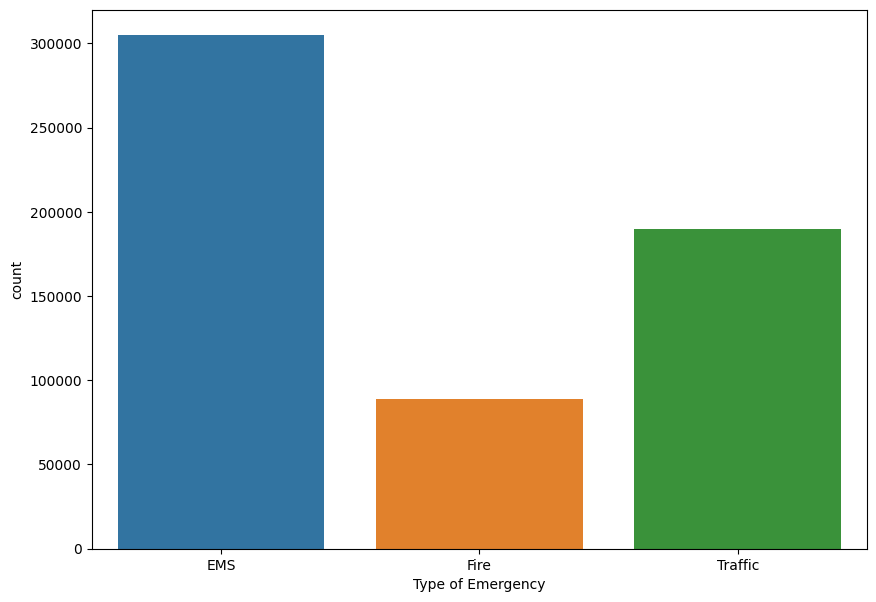

In [9]:
# !pip install seaborn==0.9.0
import seaborn as sns
plt.figure(figsize = (10,7))
sns.countplot(data=df, x=df["new_title"]).set( xlabel='Type of Emergency')
plt.show()

In [5]:
df['year'] = pd.to_datetime(df['timeStamp']).dt.year
# df['hour'] = pd.to_datetime(df['timeStamp']).dt.hour
# df['date'] = pd.to_datetime(df['timeStamp']).dt.date
# df['month'] = pd.to_datetime(df['timeStamp']).dt.month

In [18]:
by_hour =df[['new_title', 'hour']].value_counts().sort_index()
by_hour = by_hour.reset_index()

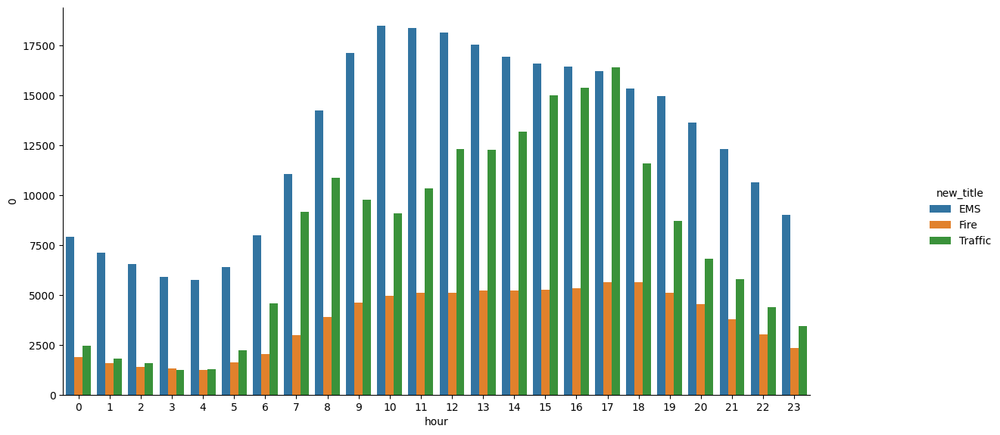

In [19]:
# Plot the count of each category for each hour
catplot =sns.catplot(x='hour', y=0, hue='new_title', data=by_hour, kind='bar')
catplot.fig.set_size_inches(15, 6)
plt.show()

In [20]:
by_month =df[['new_title', 'month']].value_counts().sort_index()
by_month = by_month.reset_index()

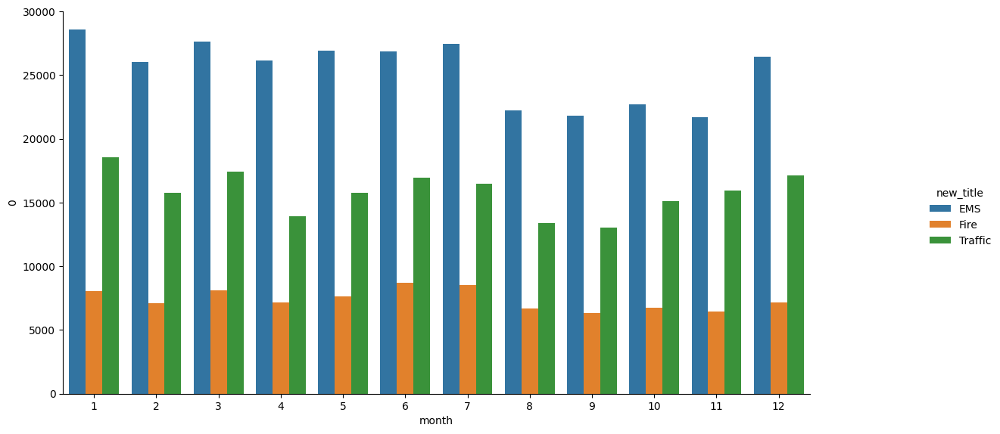

In [21]:
# Plot the count of each category for each hour
catplot =sns.catplot(x='month', y=0, hue='new_title', data=by_month, kind='bar')
catplot.fig.set_size_inches(15, 6)
plt.show()

In [22]:
by_hour_traffic = by_hour[by_hour['new_title'] == 'Traffic']

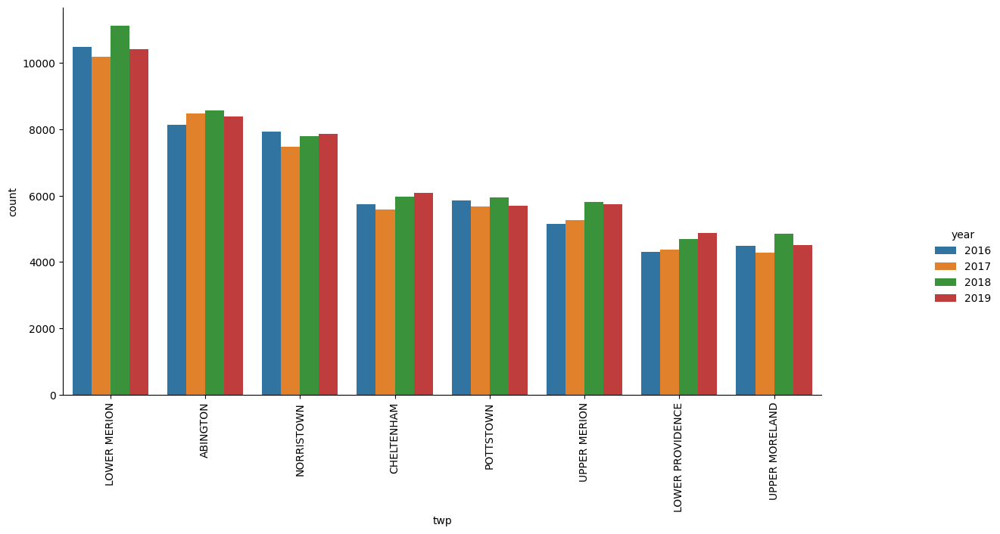

In [32]:

x = df.groupby(['twp','year']).size().reset_index()
x= x[x["year"]!=2020]
x = x.sort_values(by=0,ascending = False).head(32)
catplot =sns.catplot(x='twp', y=0, hue='year', data=x, kind='bar')
catplot.fig.set_size_inches(15, 6)
plt.ylabel("count")
plt.xticks( rotation=90)
plt.show()

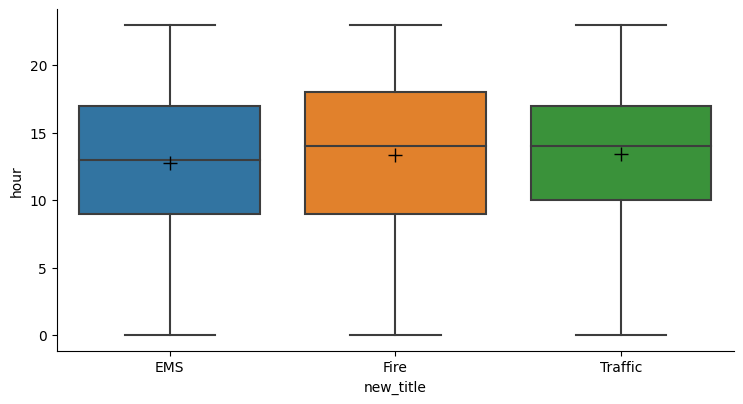

<Axes: title={'center': 'hour'}, xlabel='new_title'>

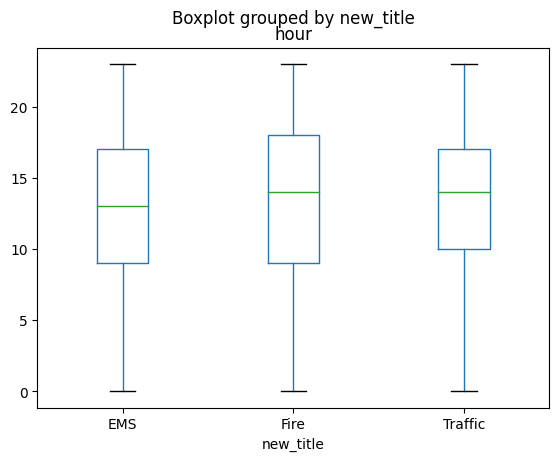

In [23]:
catplot2 = sns.catplot(data=df, x='new_title', y='hour', kind="box",showmeans=True,
            meanprops={"marker": "+",
                       "markeredgecolor": "black",
                       "markersize": "10"})
catplot2.fig.set_size_inches(8, 4)
plt.show()
df.boxplot(by ='new_title', column =['hour'], grid = False)

In [24]:
from scipy import stats
# Group the data by year and new_title and calculate the sum of events
grouped = df.groupby(['hour', 'new_title']).size().reset_index(name='count')

# Perform the ANOVA test
result = stats.f_oneway(
    grouped[grouped['new_title'] == 'EMS']['count'],
    grouped[grouped['new_title'] == 'Traffic']['count'],
    grouped[grouped['new_title'] == 'Fire']['count']
)

# Print the ANOVA test result
print("ANOVA Test Result:")
print("F-statistic:", result.statistic)
print("p-value:", result.pvalue)

ANOVA Test Result:
F-statistic: 30.4965828253151
p-value: 3.2362025070882864e-10


In [25]:
unique_combinations = df[['year', 'month']].drop_duplicates().sort_index()
unique_combinations.set_index('year',inplace = True)
print(unique_combinations)


      month
year       
2015     12
2016      1
2016      2
2016      3
2016      4
2016      5
2016      6
2016      7
2016      8
2016      9
2016     10
2016     11
2016     12
2017      1
2017      2
2017      3
2017      4
2017      5
2017      6
2017      7
2017      8
2017      9
2017     10
2017     11
2017     12
2018      1
2018      2
2018      3
2018      4
2018      5
2018      6
2018      7
2018      8
2018      9
2018     10
2018     11
2018     12
2019      1
2019      2
2019      3
2019      4
2019      5
2019      6
2019      7
2019      8
2019      9
2019     10
2019     11
2019     12
2020      1
2020      2
2020      3
2020      4
2020      5
2020      6
2020      7


<ipython-input-26-b65668998752>:13: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


(39.0, 42.0)

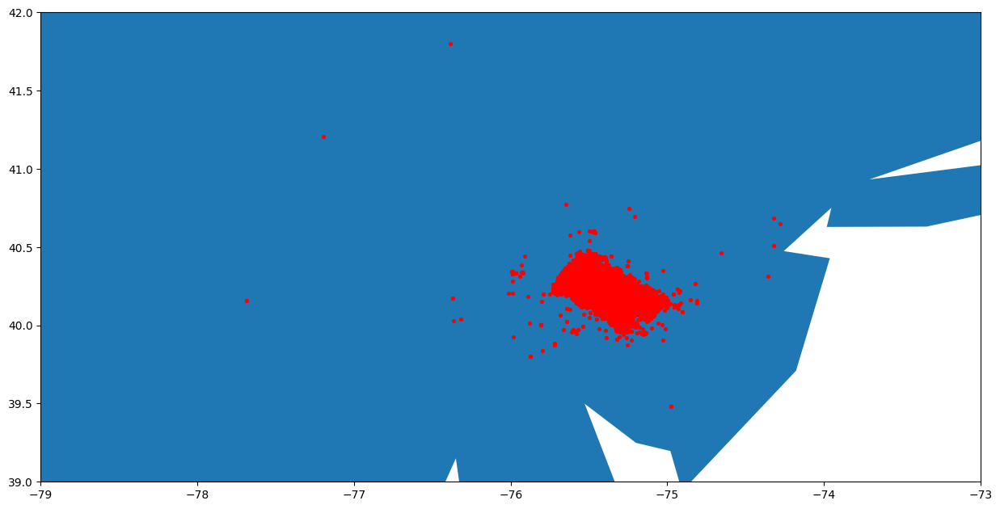

In [26]:
from shapely.geometry import Point
import geopandas as gpd
from geopandas import GeoDataFrame

# import geoplot as gplt

# df = pd.read_csv("Long_Lats.csv", delimiter=',', skiprows=0, low_memory=False)

geometry = [Point(xy) for xy in zip(df['lng'], df['lat'])]
gdf = GeoDataFrame(df, geometry=geometry)

#this is a simple map that goes with geopandas
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
x= gdf.plot(ax=world.plot(figsize=(15, 10)), marker='o', color='red', markersize=7);
x.set_xlim(-79, -73)
x.set_ylim(39, 42)


In [6]:
import plotly.express as px

# Create a scatter map plot using lat and lng columns
fig = px.scatter_mapbox(df, lat="lat", lon="lng", color = 'twp',opacity=0.3)

# Update map layout
fig.update_layout(
    mapbox_style="open-street-map",
    mapbox_zoom=9,  # Adjust the zoom level as desired
    mapbox_center={"lat": df["lat"].mean(), "lon": df["lng"].mean()},  # Set the initial center of the map
        width=1500,  # Set the width of the map frame (in pixels)
    height=900,
)

# Show the map dashboard
fig.show(fig_size=(15,10))

In [7]:
import plotly.express as px

# Filter the data for the years 2016 to 2020
df_filtered = df[(df['year'] >= 2016) & (df['year'] <= 2020)]

# Calculate the count of twp per year
twp_counts = df_filtered.groupby(['twp', 'year']).size().reset_index(name='count')

# Merge the count data with the original dataframe
df_merged = pd.merge(df_filtered, twp_counts, on=['twp', 'year'])

# Create a scatter map plot using lat and lng columns, color-coded by the count column
fig = px.scatter_mapbox(df_merged, lat="lat", lon="lng", color="count", opacity=0.3,
                        color_continuous_scale='Viridis', animation_frame="year")

# Update map layout
fig.update_layout(
    mapbox_style="open-street-map",
    mapbox_zoom=9.5,  # Adjust the zoom level as desired
    mapbox_center={"lat": df_merged["lat"].mean(), "lon": df_merged["lng"].mean()},  # Set the initial center of the map
    width=1500,  # Set the width of the map frame (in pixels)
    height=800,  # Set the height of the map frame (in pixels)
)

# Show the animation
fig.show()

<Axes: xlabel='twp', ylabel='count'>

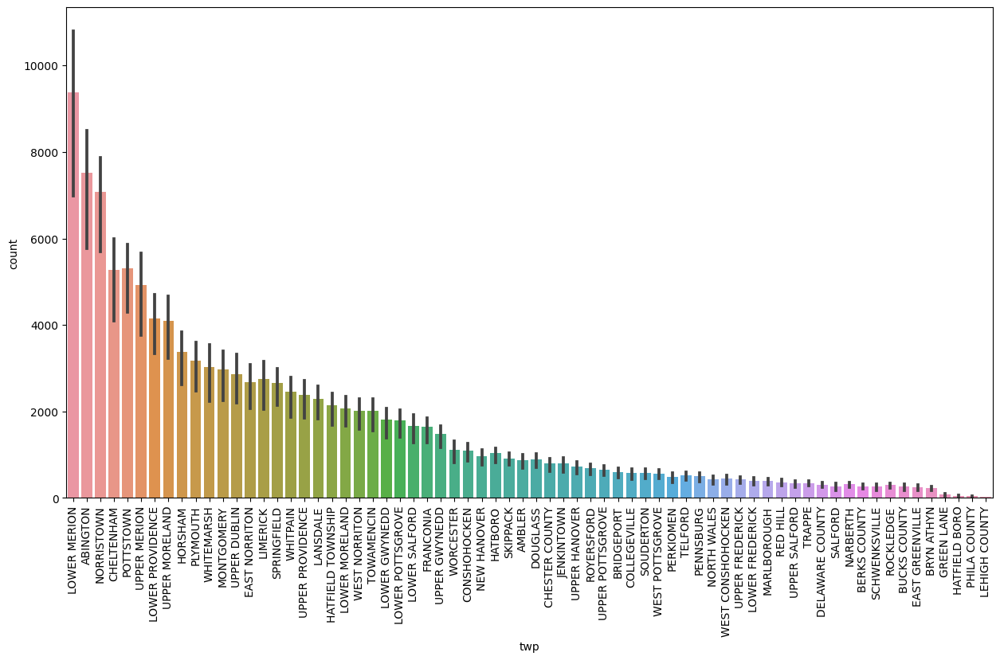

In [11]:

twp_count = df_merged[['twp','count']].drop_duplicates().sort_values(by = 'count' ,ascending = False)
plt.figure(figsize =(15,8))
plt.xticks( rotation=90)
sns.barplot(x='twp',y= 'count',data = twp_count)


In [ ]:
mean_lng = df.groupby('twp')['lng'].mean()
mean_lng

In [ ]:
year15 = df[ (df['year'] == 2015) & (df['year'] == 2020)].index

# drop these row indexes
# from dataFrame
df.drop(year15, inplace = True)
df
# df.groupby(['twp','year']).size().reset_index()
# df.boxplot(by ='twp', column =['year'], grid = False,figsize =(15,10))
